In [ ]:
!pip install --extra-index-url https://pypi.anaconda.org/scipy-wheels-nightly/simple imagecodecs

Looking in indexes: https://pypi.org/simple, https://pypi.anaconda.org/scipy-wheels-nightly/simple


In [ ]:
import os
import numpy as np
import torch
from torch.utils.data import DataLoader, Dataset
import matplotlib.pyplot as plt
from torchvision.transforms import v2
from torchvision import tv_tensors
import tifffile as tiff
from PIL import Image

In [ ]:
from google.colab import drive
drive.mount('/content/drive', force_remount=True)

Mounted at /content/drive


In [ ]:
print(os.listdir("./drive/MyDrive/dataset"))

['input', 'DIC-C2DH-HeLa-test', 'DIC-C2DH-HeLa-train']


In [ ]:
import sys
sys.path.append('/content/drive/MyDrive/')


In [ ]:
from loss_functions import soft_dice, soft_iou, hard_dice, hard_iou, combined_loss

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"using device: {device}")

using device: cuda


In [ ]:
random_seed = 42
torch.manual_seed(random_seed)

In [ ]:
class CellDataset(Dataset):
    def __init__(self, image_dir, mask_dir=None, transforms=None):
        self.image_dir = image_dir
        self.mask_dir = mask_dir
        self.transforms = transforms

        self.image_files = sorted(os.listdir(image_dir))

        if mask_dir is not None:
            self.mask_files = sorted(os.listdir(mask_dir))


            self.frame_ids = [
                f.split('.')[0][-3:] for f in self.mask_files
            ]
        else:
            self.mask_files = None
            self.frame_ids = None   

    def __len__(self):
        if self.mask_dir is None:
            return len(self.image_files)     
        return len(self.mask_files)         

    def load_tiff_norm(self, path):
        with Image.open(path) as img:
          img = img.convert("L")
          img = np.array(img, dtype=np.float32)
        max_val = img.max()
        if max_val > 0:
            img = img / max_val
        return img

    def __getitem__(self, idx):


        if self.mask_dir is None:
            image_name = self.image_files[idx]
            image_path = os.path.join(self.image_dir, image_name)

            image = self.load_tiff_norm(image_path)
            image = torch.from_numpy(image).unsqueeze(0)
            image = tv_tensors.Image(image)

            if self.transforms:
                image = self.transforms(image)

            return image


        frame_id = self.frame_ids[idx]        


        image_path = os.path.join(self.image_dir, f"t{frame_id}.tif")
        image = self.load_tiff_norm(image_path)
        image = torch.from_numpy(image).unsqueeze(0)
        image = tv_tensors.Image(image)

  
        mask_path = os.path.join(self.mask_dir, f"man_seg{frame_id}.tif")

        with Image.open(mask_path) as mask:
          mask = mask.convert("L")
          mask = np.array(mask, dtype=np.float32)
        mask = (mask > 0).astype(np.float32)

        mask = torch.from_numpy(mask).unsqueeze(0)
        mask = tv_tensors.Mask(mask)

        target = {"masks": mask}


        if self.transforms:
            image, target = self.transforms(image, target)

        return image, target["masks"]


In [ ]:
transforms = v2.Compose([
    v2.RandomHorizontalFlip(p=0.5),
    v2.RandomVerticalFlip(p=0.5),
    v2.GaussianBlur(kernel_size=3),
    v2.ElasticTransform(alpha=50.0, sigma=10),
    v2.RandomRotation(degrees=(0,180)),
    v2.ToDtype(torch.float32),
    v2.Normalize(mean=[0], std=[1])
])

test_transform = v2.Compose([
    v2.ToDtype(dtype=torch.float32),
    v2.Normalize(mean=[0], std=[1])
])


In [ ]:
def get_train_loaders(image_path, mask_path, batch_size = 1, shuffle=True, transforms=None):

    dataset = CellDataset(image_dir = image_path, mask_dir = mask_path, transforms=transforms)
    return DataLoader(dataset, batch_size=batch_size, shuffle=shuffle)

def get_test_loaders(image_path, batch_size = 1, shuffle=False, transforms=None):
    dataset = CellDataset(image_dir=image_path, mask_dir=None, transforms=transforms)
    return DataLoader(dataset, batch_size=batch_size, shuffle=shuffle)


In [ ]:
train_path = "drive/MyDrive/dataset/DIC-C2DH-HeLa-train/DIC-C2DH-HeLa/01"

train_masks = [
              "drive/MyDrive/dataset/DIC-C2DH-HeLa-train/DIC-C2DH-HeLa/01_ST/SEG",
              "drive/MyDrive/dataset/DIC-C2DH-HeLa-train/DIC-C2DH-HeLa/01_GT/SEG",
              ]

pretrain_loader = get_train_loaders(image_path=train_path,mask_path=train_masks[0], batch_size=1, shuffle=True, transforms=transforms)
finetune_loader = get_train_loaders(image_path=train_path,mask_path=train_masks[1], batch_size=1, shuffle=True, transforms=transforms)


val_path = "drive/MyDrive/dataset/DIC-C2DH-HeLa-train/DIC-C2DH-HeLa/02"
val_masks = [ "drive/MyDrive/dataset/DIC-C2DH-HeLa-train/DIC-C2DH-HeLa/02_ST/SEG",
              "drive/MyDrive/dataset/DIC-C2DH-HeLa-train/DIC-C2DH-HeLa/02_GT/SEG",
              ]

val_loader = get_train_loaders(image_path=val_path, mask_path=val_masks[0], batch_size=1, shuffle=False, transforms=test_transform)
test_loader = get_train_loaders(image_path=val_path, mask_path=val_masks[1], batch_size=1, shuffle=False, transforms=test_transform)

test_path = [
             "drive/MyDrive/dataset/DIC-C2DH-HeLa-test/DIC-C2DH-HeLa/01",
             "drive/MyDrive/dataset/DIC-C2DH-HeLa-test/DIC-C2DH-HeLa/02",
             ]

final_test_loader_01 = get_test_loaders(image_path=test_path[0], batch_size=1, shuffle=False, transforms=test_transform)
final_test_loader_02 = get_test_loaders(image_path=test_path[0], batch_size=1, shuffle=False, transforms=test_transform)

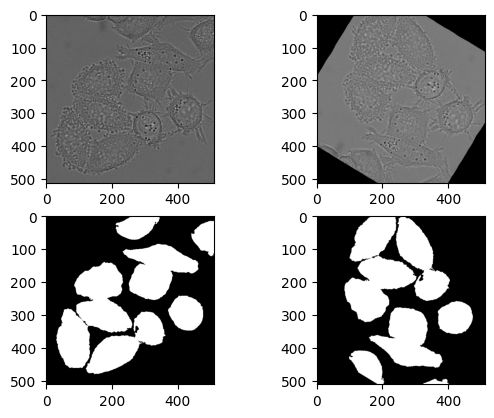

In [ ]:
dataset = CellDataset(image_dir=train_path, mask_dir=train_masks[0], transforms=None)
img1, mask1 = dataset[3]
torch.manual_seed(0)
img2, out = transforms(img1, {"masks": mask1})
mask2 = out["masks"]

plt.subplot(2,2,1); plt.imshow(img1.squeeze(), cmap='gray')
plt.subplot(2,2,2); plt.imshow(img2.squeeze(), cmap='gray')
plt.subplot(2,2,3); plt.imshow(mask1.squeeze(), cmap='gray')
plt.subplot(2,2,4); plt.imshow(mask2.squeeze(), cmap='gray')

In [ ]:
import torch.nn as nn
import torch.functional as F
from torchvision.models import resnet34, ResNet34_Weights
from torchsummary import summary

In [ ]:
net = resnet34(weights=ResNet34_Weights.IMAGENET1K_V1)

Downloading: "https://download.pytorch.org/models/resnet34-b627a593.pth" to /root/.cache/torch/hub/checkpoints/resnet34-b627a593.pth


100%|██████████| 83.3M/83.3M [00:00<00:00, 245MB/s]


In [ ]:
weights = net.conv1.weight.data.mean(dim=1).unsqueeze(dim=1)
conv_gray = nn.Conv2d(in_channels=1, out_channels=64, kernel_size=7, stride=2, padding=3, bias=False)
conv_gray.weight.data = weights

net.conv1 = conv_gray
net.conv1

Conv2d(1, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)

In [ ]:
class UpBlock(nn.Module):
    def __init__(self, in_ch, skip_ch, out_ch):
        super().__init__()
        self.up = nn.ConvTranspose2d(in_ch, out_ch, 2, stride=2)
        self.conv = nn.Sequential(
            nn.Conv2d(out_ch + skip_ch, out_ch, 3, padding=1),
            nn.ReLU(inplace=True),
            nn.Conv2d(out_ch, out_ch, 3, padding=1),
            nn.ReLU(inplace=True)
        )

    def forward(self, x, skip):
        x = self.up(x)
        x = torch.cat([x, skip], dim=1)
        return self.conv(x)

In [ ]:
class Encoder(nn.Module):
    def __init__(self, in_ch=1):
        super().__init__()

        backbone = resnet34(weights=ResNet34_Weights.IMAGENET1K_V1)

        # Convert conv1 to grayscale
        weight = backbone.conv1.weight.data.mean(dim=1, keepdim=True)
        conv_gray = nn.Conv2d(in_ch, 64, kernel_size=7, stride=2, padding=3, bias=False)
        conv_gray.weight.data = weight

        backbone.conv1 = conv_gray

        # Encoder layers
        self.layer0 = nn.Sequential(backbone.conv1, backbone.bn1, backbone.relu)
        self.maxpool = backbone.maxpool
        self.layer1  = backbone.layer1
        self.layer2  = backbone.layer2
        self.layer3  = backbone.layer3
        self.layer4  = backbone.layer4

    def forward(self, x):
        x0 = self.layer0(x)
        x1 = self.layer1(self.maxpool(x0))
        x2 = self.layer2(x1)
        x3 = self.layer3(x2)
        x4 = self.layer4(x3)
        return x0, x1, x2, x3, x4



In [ ]:
class Decoder(nn.Module):
    def __init__(self):
        super().__init__()

        self.up4 = UpBlock(512, 256, 256)
        self.up3 = UpBlock(256, 128, 128)
        self.up2 = UpBlock(128, 64, 64)
        self.up1 = UpBlock(64, 64, 64)

        self.final = nn.Conv2d(64, 1, kernel_size=1)

    def forward(self, x0, x1, x2, x3, x4, orig_size):

        d4 = self.up4(x4, x3)
        d3 = self.up3(d4, x2)
        d2 = self.up2(d3, x1)
        d1 = self.up1(d2, x0)

        out = nn.functional.interpolate(d1, size=orig_size, mode='bilinear')
        return self.final(out)



In [ ]:
class UNet(nn.Module):
    def __init__(self, in_ch=1, num_classes=1):
        super().__init__()
        self.encoder = Encoder(in_ch=in_ch)
        self.decoder = Decoder()
        self.num_classes = num_classes

    def freeze_encoder(self):
        for param in self.encoder.parameters():
            param.requires_grad = False

    def unfreeze_encoder(self):
        for param in self.encoder.parameters():
            param.requires_grad = True

    def forward(self, x):
        orig_size = x.shape[2:]
        x0, x1, x2, x3, x4 = self.encoder(x)
        return self.decoder(x0, x1, x2, x3, x4, orig_size)

In [ ]:
model = UNet(in_ch=1, num_classes=1)

In [ ]:
model.to(device);
model.freeze_encoder()
summary(model, (1,512,512))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 64, 256, 256]           3,136
       BatchNorm2d-2         [-1, 64, 256, 256]             128
              ReLU-3         [-1, 64, 256, 256]               0
         MaxPool2d-4         [-1, 64, 128, 128]               0
            Conv2d-5         [-1, 64, 128, 128]          36,864
       BatchNorm2d-6         [-1, 64, 128, 128]             128
              ReLU-7         [-1, 64, 128, 128]               0
            Conv2d-8         [-1, 64, 128, 128]          36,864
       BatchNorm2d-9         [-1, 64, 128, 128]             128
             ReLU-10         [-1, 64, 128, 128]               0
       BasicBlock-11         [-1, 64, 128, 128]               0
           Conv2d-12         [-1, 64, 128, 128]          36,864
      BatchNorm2d-13         [-1, 64, 128, 128]             128
             ReLU-14         [-1, 64, 1

In [ ]:
def checkpoint(model, filename):
    torch.save(model.state_dict(), filename)

def resume(model, path, device="cpu"):
    ckpt = torch.load(path, map_location=device)

    if "model_state_dict" in ckpt:
        model.load_state_dict(ckpt["model_state_dict"])
    elif "model" in ckpt:
        model.load_state_dict(ckpt["model"])
    else:
        model.load_state_dict(ckpt)

    print("Checkpoint loaded successfully.")
    return model


In [ ]:
from tqdm.auto import tqdm

In [ ]:
def train(model, epoch, train, dataloader, optimizer, device, BCE, dice_score=soft_dice, iou_score=soft_iou):

    model.train()

    total_loss = 0.0
    total_dice = 0.0
    total_iou = 0.0
    batch_count = 0

    for Image, Mask in tqdm(dataloader):
        X = Image.to(device)
        y = Mask.to(device).float()

        optimizer.zero_grad()

        logits = model(X)


        if train == "Finetune":
            loss = BCE(logits, y) + (1 - dice_score(logits, y))
        else:
            loss = combined_loss(logits=logits, targets=y, bce_loss=BCE, alpha=0.3)

        loss.backward()
        optimizer.step()

        total_loss += loss.item()

 
        with torch.no_grad():
            dice_val = dice_score(logits.detach(), y).item()
            iou_val  = iou_score(logits.detach(), y).item()

            total_dice += dice_val
            total_iou  += iou_val

            batch_count += 1


    avg_loss = total_loss / batch_count
    avg_dice = total_dice / batch_count
    avg_iou  = total_iou  / batch_count

    print(f"{train} Epoch {epoch} | "
          f"Loss: {avg_loss:.4f} | Dice: {avg_dice:.4f} | IoU: {avg_iou:.4f}")

    return avg_loss, avg_dice, avg_iou


In [ ]:
def test(
    model,
    dataloader,
    device,
    BCE,
    epoch,
    dice_score=hard_dice,
    iou_score=hard_iou,
    mode="Test"
):
    model.eval()

    total_loss = 0.0
    total_dice = 0.0
    total_iou = 0.0
    batch_count = 0

    with torch.inference_mode():
        for images, masks in tqdm(dataloader):
            images = images.to(device)
            masks = masks.to(device).float()

            logits = model(images)


            dice_val = dice_score(logits, masks)
            loss = BCE(logits, masks) + (1 - dice_val)


            total_loss += loss.item()
            total_dice += dice_val.item()
            total_iou  += iou_score(logits, masks).item()

            batch_count += 1


    avg_loss = total_loss / batch_count
    avg_dice = total_dice / batch_count
    avg_iou  = total_iou  / batch_count

    print(
        f"{mode} Epoch: {epoch} | "
        f"Loss: {avg_loss:.4f} | Dice: {avg_dice:.4f} | IoU: {avg_iou:.4f}"
    )

    return avg_loss, avg_dice, avg_iou


In [ ]:
pretrain_train_losses = []
pretrain_dice_scores = []
pretrain_iou_scores = []

pretrain_val_train_losses = []
pretrain_val_dice_scores = []
pretrain_val_iou_scores = []

optimizer = torch.optim.Adam(model.parameters(), lr=1e-4)
loss_fn = nn.BCEWithLogitsLoss()
epochs = 50

early_stopping_thresh = 10
best_score = -1
best_epoch = -1

for epoch in range(epochs):
    tr_loss, tr_dice_score, tr_iou_score = train(model=model, epoch=epoch+1, train="Pre-Train", dataloader=pretrain_loader, optimizer=optimizer, device=device, BCE=loss_fn)
    val_loss, val_dice_score, val_iou_score = test(model=model, epoch=epoch+1, dataloader=val_loader, device=device, BCE=loss_fn, mode="Val")
    print("*"*20)
    pretrain_train_losses.append(tr_loss)
    pretrain_dice_scores.append(tr_dice_score)
    pretrain_iou_scores.append(tr_iou_score)

    pretrain_val_train_losses.append(val_loss)
    pretrain_val_dice_scores.append(val_dice_score)
    pretrain_val_iou_scores.append(val_iou_score)

    if ((val_dice_score + val_iou_score) / 2) > best_score:
        best_score = (val_dice_score + val_iou_score) / 2
        best_epoch = epoch
        checkpoint(model, f"drive/MyDrive/models/pretrain_best_model_nsa.pth")
        print(f"Model Checkpointed at Best Epoch: {epoch+1}")
    elif epoch - best_epoch > early_stopping_thresh:
        print(f"Early Stopped Training at Epoch: {epoch+1}")
        break

print(f"Pre-training best model from epoch: {best_epoch}, Best Score: {best_score}")

  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 1 | Loss: 0.4390 | Dice: 0.6403 | IoU: 0.4796


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 1 | Loss: 0.8105 | Dice: 0.7386 | IoU: 0.5902
********************
Model Checkpointed at Best Epoch: 1


  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 2 | Loss: 0.2282 | Dice: 0.8261 | IoU: 0.7050


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 2 | Loss: 0.4315 | Dice: 0.8786 | IoU: 0.7840
********************
Model Checkpointed at Best Epoch: 2


  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 3 | Loss: 0.1833 | Dice: 0.8624 | IoU: 0.7587


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 3 | Loss: 0.5809 | Dice: 0.8353 | IoU: 0.7182
********************


  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 4 | Loss: 0.1764 | Dice: 0.8658 | IoU: 0.7640


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 4 | Loss: 0.3925 | Dice: 0.8929 | IoU: 0.8068
********************
Model Checkpointed at Best Epoch: 4


  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 5 | Loss: 0.1595 | Dice: 0.8788 | IoU: 0.7845


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 5 | Loss: 0.3578 | Dice: 0.9036 | IoU: 0.8245
********************
Model Checkpointed at Best Epoch: 5


  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 6 | Loss: 0.1519 | Dice: 0.8855 | IoU: 0.7950


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 6 | Loss: 0.4004 | Dice: 0.8962 | IoU: 0.8122
********************


  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 7 | Loss: 0.1404 | Dice: 0.8938 | IoU: 0.8084


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 7 | Loss: 0.3644 | Dice: 0.9066 | IoU: 0.8295
********************
Model Checkpointed at Best Epoch: 7


  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 8 | Loss: 0.1352 | Dice: 0.8977 | IoU: 0.8146


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 8 | Loss: 0.4375 | Dice: 0.8851 | IoU: 0.7942
********************


  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 9 | Loss: 0.1324 | Dice: 0.9002 | IoU: 0.8189


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 9 | Loss: 0.3292 | Dice: 0.9171 | IoU: 0.8472
********************
Model Checkpointed at Best Epoch: 9


  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 10 | Loss: 0.1226 | Dice: 0.9080 | IoU: 0.8318


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 10 | Loss: 0.3264 | Dice: 0.9172 | IoU: 0.8473
********************
Model Checkpointed at Best Epoch: 10


  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 11 | Loss: 0.1190 | Dice: 0.9101 | IoU: 0.8353


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 11 | Loss: 0.3613 | Dice: 0.9153 | IoU: 0.8442
********************


  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 12 | Loss: 0.1179 | Dice: 0.9117 | IoU: 0.8379


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 12 | Loss: 0.4084 | Dice: 0.8966 | IoU: 0.8128
********************


  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 13 | Loss: 0.1159 | Dice: 0.9134 | IoU: 0.8408


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 13 | Loss: 0.3997 | Dice: 0.9013 | IoU: 0.8208
********************


  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 14 | Loss: 0.1119 | Dice: 0.9166 | IoU: 0.8463


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 14 | Loss: 0.3292 | Dice: 0.9144 | IoU: 0.8426
********************


  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 15 | Loss: 0.1094 | Dice: 0.9180 | IoU: 0.8487


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 15 | Loss: 0.3164 | Dice: 0.9211 | IoU: 0.8540
********************
Model Checkpointed at Best Epoch: 15


  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 16 | Loss: 0.1051 | Dice: 0.9213 | IoU: 0.8544


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 16 | Loss: 0.3314 | Dice: 0.9176 | IoU: 0.8480
********************


  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 17 | Loss: 0.1095 | Dice: 0.9182 | IoU: 0.8492


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 17 | Loss: 0.3582 | Dice: 0.9174 | IoU: 0.8478
********************


  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 18 | Loss: 0.1043 | Dice: 0.9225 | IoU: 0.8565


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 18 | Loss: 0.2980 | Dice: 0.9235 | IoU: 0.8581
********************
Model Checkpointed at Best Epoch: 18


  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 19 | Loss: 0.1051 | Dice: 0.9213 | IoU: 0.8544


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 19 | Loss: 0.3251 | Dice: 0.9211 | IoU: 0.8541
********************


  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 20 | Loss: 0.1010 | Dice: 0.9253 | IoU: 0.8612


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 20 | Loss: 0.2971 | Dice: 0.9279 | IoU: 0.8658
********************
Model Checkpointed at Best Epoch: 20


  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 21 | Loss: 0.0996 | Dice: 0.9259 | IoU: 0.8623


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 21 | Loss: 0.3295 | Dice: 0.9201 | IoU: 0.8524
********************


  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 22 | Loss: 0.0992 | Dice: 0.9257 | IoU: 0.8621


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 22 | Loss: 0.2922 | Dice: 0.9309 | IoU: 0.8711
********************
Model Checkpointed at Best Epoch: 22


  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 23 | Loss: 0.0982 | Dice: 0.9271 | IoU: 0.8644


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 23 | Loss: 0.2976 | Dice: 0.9277 | IoU: 0.8656
********************


  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 24 | Loss: 0.0961 | Dice: 0.9285 | IoU: 0.8668


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 24 | Loss: 0.3839 | Dice: 0.9062 | IoU: 0.8289
********************


  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 25 | Loss: 0.0992 | Dice: 0.9266 | IoU: 0.8636


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 25 | Loss: 0.3328 | Dice: 0.9167 | IoU: 0.8467
********************


  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 26 | Loss: 0.0961 | Dice: 0.9285 | IoU: 0.8668


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 26 | Loss: 0.3681 | Dice: 0.9126 | IoU: 0.8398
********************


  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 27 | Loss: 0.0945 | Dice: 0.9296 | IoU: 0.8687


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 27 | Loss: 0.3197 | Dice: 0.9218 | IoU: 0.8552
********************


  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 28 | Loss: 0.0944 | Dice: 0.9296 | IoU: 0.8687


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 28 | Loss: 0.3012 | Dice: 0.9290 | IoU: 0.8677
********************


  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 29 | Loss: 0.0914 | Dice: 0.9319 | IoU: 0.8727


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 29 | Loss: 0.3057 | Dice: 0.9235 | IoU: 0.8582
********************


  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 30 | Loss: 0.0939 | Dice: 0.9300 | IoU: 0.8694


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 30 | Loss: 0.3259 | Dice: 0.9183 | IoU: 0.8493
********************


  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 31 | Loss: 0.0910 | Dice: 0.9320 | IoU: 0.8730


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 31 | Loss: 0.2728 | Dice: 0.9340 | IoU: 0.8765
********************
Model Checkpointed at Best Epoch: 31


  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 32 | Loss: 0.0919 | Dice: 0.9318 | IoU: 0.8725


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 32 | Loss: 0.3249 | Dice: 0.9218 | IoU: 0.8552
********************


  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 33 | Loss: 0.0895 | Dice: 0.9337 | IoU: 0.8760


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 33 | Loss: 0.2833 | Dice: 0.9285 | IoU: 0.8669
********************


  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 34 | Loss: 0.0919 | Dice: 0.9316 | IoU: 0.8723


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 34 | Loss: 0.3692 | Dice: 0.9090 | IoU: 0.8336
********************


  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 35 | Loss: 0.0892 | Dice: 0.9337 | IoU: 0.8759


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 35 | Loss: 0.3037 | Dice: 0.9281 | IoU: 0.8662
********************


  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 36 | Loss: 0.0888 | Dice: 0.9340 | IoU: 0.8765


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 36 | Loss: 0.3615 | Dice: 0.9155 | IoU: 0.8445
********************


  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 37 | Loss: 0.0887 | Dice: 0.9337 | IoU: 0.8759


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 37 | Loss: 0.3280 | Dice: 0.9264 | IoU: 0.8633
********************


  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 38 | Loss: 0.0881 | Dice: 0.9348 | IoU: 0.8779


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 38 | Loss: 0.2841 | Dice: 0.9302 | IoU: 0.8699
********************


  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 39 | Loss: 0.0926 | Dice: 0.9314 | IoU: 0.8721


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 39 | Loss: 0.2715 | Dice: 0.9321 | IoU: 0.8731
********************


  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 40 | Loss: 0.0883 | Dice: 0.9343 | IoU: 0.8769


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 40 | Loss: 0.2843 | Dice: 0.9309 | IoU: 0.8710
********************


  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 41 | Loss: 0.0862 | Dice: 0.9357 | IoU: 0.8795


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 41 | Loss: 0.3727 | Dice: 0.9163 | IoU: 0.8460
********************


  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 42 | Loss: 0.0904 | Dice: 0.9330 | IoU: 0.8747


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 42 | Loss: 0.2942 | Dice: 0.9314 | IoU: 0.8719
********************
Early Stopped Training at Epoch: 42
Pre-training best model from epoch: 30, Best Score: 0.9052731948239463


In [ ]:
model = UNet(in_ch=1, num_classes=1)
model = resume(model=model, path="drive/MyDrive/models/pretrain_best_model_nsa.pth", device=device)
print(f"Loaded Model from Epoch: {best_epoch}")

Checkpoint loaded successfully.
Loaded Model from Epoch: 30


In [ ]:
model.unfreeze_encoder()
model.to(device);
encoder = []
decoder = []

for param in model.encoder.parameters():
    encoder.append(param)

for param in model.decoder.parameters():
    decoder.append(param)

optimizer = torch.optim.Adam([
    {"params": encoder, "lr": 1e-5},
    {"params": decoder, "lr": 1e-4}
])

In [ ]:
finetune_train_losses = []
finetune_dice_scores = []
finetune_iou_scores = []

finetune_val_train_losses = []
finetune_val_dice_scores = []
finetune_val_iou_scores = []

loss_fn = nn.BCEWithLogitsLoss()
epochs = 50

early_stopping_thresh = 10
best_score = -1
best_epoch = -1

# Explicitly ensure the problematic conv_gray layer is on the correct device
# This addresses the RuntimeError: Input type (torch.cuda.FloatTensor) and weight type (torch.FloatTensor) should be the same
# which likely occurs due to the direct assignment to .weight.data in the Encoder's __init__.
if hasattr(model.encoder, 'layer0') and isinstance(model.encoder.layer0, nn.Sequential) and len(model.encoder.layer0) > 0:
    if hasattr(model.encoder.layer0[0], 'weight'):
        model.encoder.layer0[0].to(device)

for epoch in range(epochs):
    tr_loss, tr_dice_score, tr_iou_score = train(model=model, epoch=epoch+1, train="Finetune", dataloader=finetune_loader, optimizer=optimizer, device=device, BCE=loss_fn)
    val_loss, val_dice_score, val_iou_score = test(model=model, epoch=epoch+1, dataloader=val_loader, device=device, BCE=loss_fn, mode="Val")
    print("*"*20)
    finetune_train_losses.append(tr_loss)
    finetune_dice_scores.append(tr_dice_score)
    finetune_iou_scores.append(tr_iou_score)

    finetune_val_train_losses.append(val_loss)
    finetune_val_dice_scores.append(val_dice_score)
    finetune_val_iou_scores.append(val_iou_score)

    if ((val_dice_score + val_iou_score) / 2) > best_score:
        best_score = tr_dice_score
        best_epoch = epoch
        checkpoint(model, f"drive/MyDrive/models/finetune_best_model_nsa.pth")
        print(f"Model Checkpointed at Best Epoch: {epoch+1}")
    elif epoch - best_epoch > early_stopping_thresh:
        print(f"Early Stopped Training at Epoch: {epoch+1}")
        break

print(f"Finetuning best model from epoch: {best_epoch+1}, Best Score: {best_score}")

  0%|          | 0/9 [00:00<?, ?it/s]

Finetune Epoch 1 | Loss: 0.5841 | Dice: 0.8245 | IoU: 0.7381


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 1 | Loss: 0.2624 | Dice: 0.9293 | IoU: 0.8684
********************
Model Checkpointed at Best Epoch: 1


  0%|          | 0/9 [00:00<?, ?it/s]

Finetune Epoch 2 | Loss: 0.5204 | Dice: 0.8170 | IoU: 0.7282


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 2 | Loss: 0.3958 | Dice: 0.8980 | IoU: 0.8157
********************
Model Checkpointed at Best Epoch: 2


  0%|          | 0/9 [00:00<?, ?it/s]

Finetune Epoch 3 | Loss: 0.4522 | Dice: 0.8110 | IoU: 0.7140


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 3 | Loss: 0.4309 | Dice: 0.8950 | IoU: 0.8108
********************
Model Checkpointed at Best Epoch: 3


  0%|          | 0/9 [00:00<?, ?it/s]

Finetune Epoch 4 | Loss: 0.4870 | Dice: 0.8278 | IoU: 0.7436


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 4 | Loss: 0.2815 | Dice: 0.9273 | IoU: 0.8648
********************
Model Checkpointed at Best Epoch: 4


  0%|          | 0/9 [00:00<?, ?it/s]

Finetune Epoch 5 | Loss: 0.4161 | Dice: 0.8379 | IoU: 0.7581


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 5 | Loss: 0.5237 | Dice: 0.8701 | IoU: 0.7710
********************


  0%|          | 0/9 [00:00<?, ?it/s]

Finetune Epoch 6 | Loss: 0.4639 | Dice: 0.8044 | IoU: 0.7032


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 6 | Loss: 0.3393 | Dice: 0.9107 | IoU: 0.8365
********************
Model Checkpointed at Best Epoch: 6


  0%|          | 0/9 [00:00<?, ?it/s]

Finetune Epoch 7 | Loss: 0.4864 | Dice: 0.8187 | IoU: 0.7298


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 7 | Loss: 0.2669 | Dice: 0.9298 | IoU: 0.8693
********************
Model Checkpointed at Best Epoch: 7


  0%|          | 0/9 [00:00<?, ?it/s]

Finetune Epoch 8 | Loss: 0.4574 | Dice: 0.8140 | IoU: 0.7197


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 8 | Loss: 0.4978 | Dice: 0.8765 | IoU: 0.7813
********************
Model Checkpointed at Best Epoch: 8


  0%|          | 0/9 [00:00<?, ?it/s]

Finetune Epoch 9 | Loss: 0.4274 | Dice: 0.8263 | IoU: 0.7393


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 9 | Loss: 0.2988 | Dice: 0.9214 | IoU: 0.8546
********************
Model Checkpointed at Best Epoch: 9


  0%|          | 0/9 [00:00<?, ?it/s]

Finetune Epoch 10 | Loss: 0.4292 | Dice: 0.8246 | IoU: 0.7367


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 10 | Loss: 0.4962 | Dice: 0.8751 | IoU: 0.7792
********************
Model Checkpointed at Best Epoch: 10


  0%|          | 0/9 [00:00<?, ?it/s]

Finetune Epoch 11 | Loss: 0.4143 | Dice: 0.8170 | IoU: 0.7191


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 11 | Loss: 0.2707 | Dice: 0.9281 | IoU: 0.8663
********************
Model Checkpointed at Best Epoch: 11


  0%|          | 0/9 [00:00<?, ?it/s]

Finetune Epoch 12 | Loss: 0.4612 | Dice: 0.8291 | IoU: 0.7461


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 12 | Loss: 0.3312 | Dice: 0.9141 | IoU: 0.8423
********************
Model Checkpointed at Best Epoch: 12


  0%|          | 0/9 [00:00<?, ?it/s]

Finetune Epoch 13 | Loss: 0.4043 | Dice: 0.8329 | IoU: 0.7465


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 13 | Loss: 0.6228 | Dice: 0.8591 | IoU: 0.7545
********************


  0%|          | 0/9 [00:00<?, ?it/s]

Finetune Epoch 14 | Loss: 0.4311 | Dice: 0.8321 | IoU: 0.7467


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 14 | Loss: 0.3361 | Dice: 0.9125 | IoU: 0.8398
********************
Model Checkpointed at Best Epoch: 14


  0%|          | 0/9 [00:00<?, ?it/s]

Finetune Epoch 15 | Loss: 0.3855 | Dice: 0.8378 | IoU: 0.7538


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 15 | Loss: 0.6061 | Dice: 0.8494 | IoU: 0.7405
********************


  0%|          | 0/9 [00:00<?, ?it/s]

Finetune Epoch 16 | Loss: 0.4602 | Dice: 0.8002 | IoU: 0.6957


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 16 | Loss: 0.2759 | Dice: 0.9248 | IoU: 0.8606
********************
Model Checkpointed at Best Epoch: 16


  0%|          | 0/9 [00:00<?, ?it/s]

Finetune Epoch 17 | Loss: 0.4573 | Dice: 0.8304 | IoU: 0.7465


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 17 | Loss: 0.3392 | Dice: 0.9050 | IoU: 0.8270
********************
Model Checkpointed at Best Epoch: 17


  0%|          | 0/9 [00:00<?, ?it/s]

Finetune Epoch 18 | Loss: 0.3870 | Dice: 0.8296 | IoU: 0.7381


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 18 | Loss: 0.5511 | Dice: 0.8558 | IoU: 0.7496
********************


  0%|          | 0/9 [00:00<?, ?it/s]

Finetune Epoch 19 | Loss: 0.4203 | Dice: 0.8168 | IoU: 0.7177


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 19 | Loss: 0.2914 | Dice: 0.9215 | IoU: 0.8549
********************
Model Checkpointed at Best Epoch: 19


  0%|          | 0/9 [00:00<?, ?it/s]

Finetune Epoch 20 | Loss: 0.4103 | Dice: 0.8359 | IoU: 0.7525


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 20 | Loss: 0.3743 | Dice: 0.9063 | IoU: 0.8293
********************
Model Checkpointed at Best Epoch: 20


  0%|          | 0/9 [00:00<?, ?it/s]

Finetune Epoch 21 | Loss: 0.4637 | Dice: 0.8119 | IoU: 0.7088


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 21 | Loss: 0.5505 | Dice: 0.8596 | IoU: 0.7558
********************


  0%|          | 0/9 [00:00<?, ?it/s]

Finetune Epoch 22 | Loss: 0.4513 | Dice: 0.8337 | IoU: 0.7513


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 22 | Loss: 0.3057 | Dice: 0.9149 | IoU: 0.8437
********************
Model Checkpointed at Best Epoch: 22


  0%|          | 0/9 [00:00<?, ?it/s]

Finetune Epoch 23 | Loss: 0.3603 | Dice: 0.8319 | IoU: 0.7376


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 23 | Loss: 0.5785 | Dice: 0.8386 | IoU: 0.7240
********************


  0%|          | 0/9 [00:00<?, ?it/s]

Finetune Epoch 24 | Loss: 0.3807 | Dice: 0.8327 | IoU: 0.7420


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 24 | Loss: 0.5436 | Dice: 0.8620 | IoU: 0.7595
********************


  0%|          | 0/9 [00:00<?, ?it/s]

Finetune Epoch 25 | Loss: 0.3414 | Dice: 0.8479 | IoU: 0.7544


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 25 | Loss: 0.5288 | Dice: 0.8731 | IoU: 0.7767
********************


  0%|          | 0/9 [00:00<?, ?it/s]

Finetune Epoch 26 | Loss: 0.3414 | Dice: 0.8554 | IoU: 0.7725


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 26 | Loss: 0.6066 | Dice: 0.8534 | IoU: 0.7467
********************


  0%|          | 0/9 [00:00<?, ?it/s]

Finetune Epoch 27 | Loss: 0.3240 | Dice: 0.8584 | IoU: 0.7735


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 27 | Loss: 0.5782 | Dice: 0.8545 | IoU: 0.7479
********************


  0%|          | 0/9 [00:00<?, ?it/s]

Finetune Epoch 28 | Loss: 0.2766 | Dice: 0.8755 | IoU: 0.7945


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 28 | Loss: 0.5809 | Dice: 0.8566 | IoU: 0.7513
********************


  0%|          | 0/9 [00:00<?, ?it/s]

Finetune Epoch 29 | Loss: 0.2901 | Dice: 0.8752 | IoU: 0.7954


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 29 | Loss: 0.5768 | Dice: 0.8587 | IoU: 0.7544
********************


  0%|          | 0/9 [00:00<?, ?it/s]

Finetune Epoch 30 | Loss: 0.2791 | Dice: 0.8780 | IoU: 0.7944


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 30 | Loss: 0.6218 | Dice: 0.8573 | IoU: 0.7525
********************


  0%|          | 0/9 [00:00<?, ?it/s]

Finetune Epoch 31 | Loss: 0.2718 | Dice: 0.8804 | IoU: 0.8001


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 31 | Loss: 0.6078 | Dice: 0.8607 | IoU: 0.7575
********************


  0%|          | 0/9 [00:00<?, ?it/s]

Finetune Epoch 32 | Loss: 0.3358 | Dice: 0.8631 | IoU: 0.7856


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 32 | Loss: 0.5687 | Dice: 0.8667 | IoU: 0.7665
********************


  0%|          | 0/9 [00:00<?, ?it/s]

Finetune Epoch 33 | Loss: 0.3495 | Dice: 0.8477 | IoU: 0.7568


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 33 | Loss: 0.5517 | Dice: 0.8637 | IoU: 0.7626
********************
Early Stopped Training at Epoch: 33
Finetuning best model from epoch: 22, Best Score: 0.8336885968844095


In [ ]:
model = UNet(in_ch=1, num_classes=1)
resume(model, "drive/MyDrive/models/finetune_best_model_nsa.pth", device)
model.to(device);
print(f"Finetuning best model from epoch: {best_epoch}, Best Score: {best_score}")


Checkpoint loaded successfully.


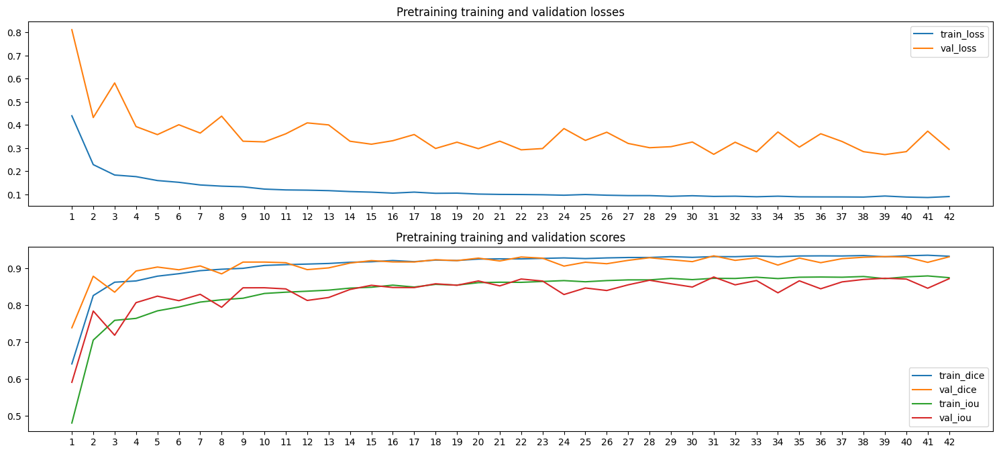

In [ ]:
plt.figure(figsize=(15,10))
plt.subplot(3,1,1); plt.plot(pretrain_train_losses, label="train_loss"); plt.title("Pretraining training and validation losses"); plt.plot(pretrain_val_train_losses, label="val_loss"); plt.legend()
plt.xticks(range(len(pretrain_train_losses)), range(1, len(pretrain_train_losses)+1))

plt.subplot(3,1,2); plt.plot(pretrain_dice_scores, label="train_dice"); plt.title("Pretraining training and validation scores"); plt.plot(pretrain_val_dice_scores, label="val_dice");
plt.plot(pretrain_iou_scores, label="train_iou"); plt.plot(pretrain_val_iou_scores, label="val_iou"); plt.legend()
plt.xticks(range(len(pretrain_val_iou_scores)), range(1, len(pretrain_val_iou_scores)+1))
plt.tight_layout()
plt.show()

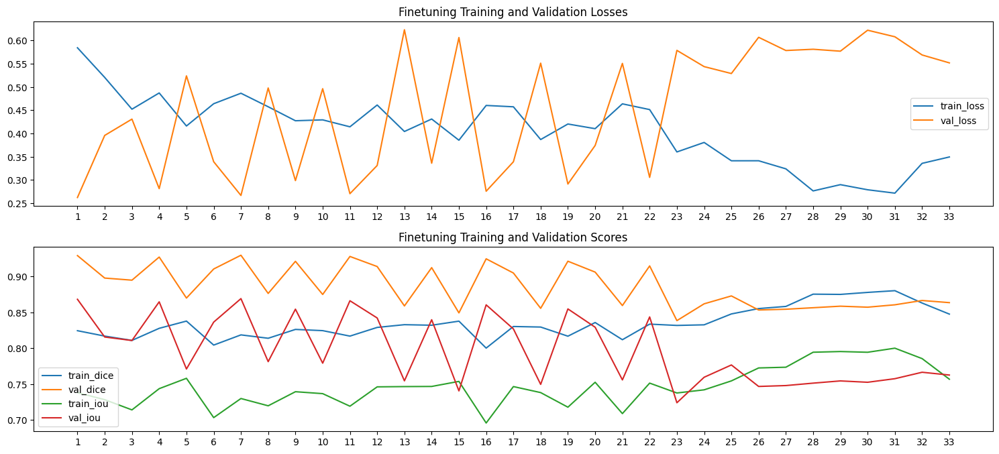

In [ ]:
plt.figure(figsize=(15,10))
plt.subplot(3,1,1); plt.plot(finetune_train_losses, label="train_loss"); plt.title("Finetuning Training and Validation Losses"); plt.plot(finetune_val_train_losses, label="val_loss");
plt.xticks(range(len(finetune_val_train_losses)), range(1, len(finetune_val_train_losses)+1))
plt.legend()

plt.subplot(3,1,2); plt.plot(finetune_dice_scores, label="train_dice"); plt.title("Finetuning Training and Validation Scores"); plt.plot(finetune_val_dice_scores, label="val_dice");
plt.plot(finetune_iou_scores, label="train_iou"); plt.plot(finetune_val_iou_scores, label="val_iou"); plt.legend()
plt.xticks(range(len(finetune_dice_scores)), range(1, len(finetune_dice_scores)+1))
plt.tight_layout()
plt.show()

In [ ]:
loss = nn.BCEWithLogitsLoss()
test_loss, test_dice, test_iou = test(model=model, dataloader=test_loader, epoch=1, device=device, BCE=loss)

  0%|          | 0/9 [00:00<?, ?it/s]

Test Epoch: 1 | Loss: 0.3421 | Dice: 0.9030 | IoU: 0.8239


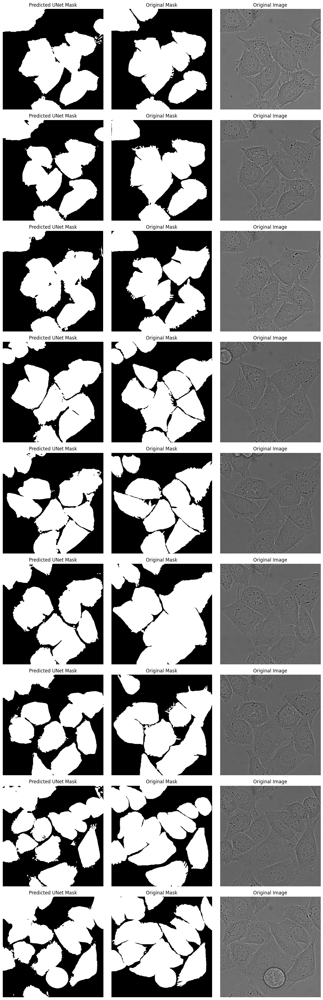

In [ ]:
model.eval()
fig, axes = plt.subplots(nrows=len(test_loader), ncols=3, figsize=(12, 4*len(test_loader)))

with torch.inference_mode():
    for idx, (img, mask) in enumerate(test_loader):
        img_cpu = img.squeeze().cpu().numpy()
        mask_cpu = mask.squeeze().cpu().numpy()
        pred_cpu = (torch.sigmoid(model(img.to(device))).squeeze().cpu().numpy() > 0.5).astype(float)

        # Predicted mask
        axes[idx, 0].imshow(pred_cpu, cmap="gray")
        axes[idx, 0].set_title("Predicted UNet Mask")
        axes[idx, 0].axis("off")

        axes[idx, 1].imshow(mask_cpu, cmap="gray")
        axes[idx, 1].set_title("Original Mask")
        axes[idx, 1].axis("off")
        # Original image
        axes[idx, 2].imshow(img_cpu, cmap="gray")
        axes[idx, 2].set_title("Original Image")
        axes[idx, 2].axis("off")

plt.tight_layout()
plt.show()


In [ ]:
import pandas as pd

pretrain_metrics = pd.DataFrame({
    "pretrain_train_loss": pretrain_train_losses,
    "pretrain_val_loss": pretrain_val_train_losses,
    "pretrain_train_dice": pretrain_dice_scores,
    "pretrain_val_dice": pretrain_val_dice_scores,
    "pretrain_train_iou": pretrain_iou_scores,
    "pretrain_val_iou": pretrain_val_iou_scores
})

finetune_metrics = pd.DataFrame({
    "finetune_train_loss": finetune_train_losses,
    "finetune_val_loss": finetune_val_train_losses,
    "finetune_train_dice": finetune_dice_scores,
    "finetune_val_dice": finetune_val_dice_scores,
    "finetune_train_iou": finetune_iou_scores,
    "finetune_val_iou": finetune_val_iou_scores
})

pretrain_metrics.to_csv("drive/MyDrive/models/pretrain_metrics_nsa.csv", index=False)
finetune_metrics.to_csv("drive/MyDrive/models/finetune_metrics_nsa.csv", index=False)

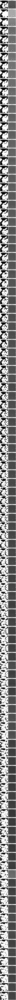

In [ ]:
model.eval()
fig, axes = plt.subplots(nrows=len(final_test_loader_02), ncols=2, figsize=(8, 4*len(final_test_loader_02)))

with torch.inference_mode():
    for idx, (img) in enumerate(final_test_loader_02):
        img_cpu = img.squeeze().cpu().numpy()
        pred_cpu = (torch.sigmoid(model(img.to(device))).squeeze().cpu().numpy() > 0.5).astype(float)

        # Predicted mask
        axes[idx, 0].imshow(pred_cpu, cmap="gray")
        axes[idx, 0].set_title("Predicted Mask - U-Net")
        axes[idx, 0].axis("off")

        # Original image
        axes[idx, 1].imshow(img_cpu, cmap="gray")
        axes[idx, 1].set_title("Original Image")
        axes[idx, 1].axis("off")

plt.tight_layout()
plt.show()


In [ ]:
import cv2

def get_binary_mask(model, img, device):
    img = test_transform(img)
    with torch.inference_mode():
        mask = torch.sigmoid(model(img.to(device))).squeeze().cpu().detach().numpy() > 0.5
    return mask.astype(np.uint8) * 255

def opening(mask, kernel):
    return cv2.dilate(cv2.erode(mask, kernel), kernel)

def closing(mask, kernel):
    return cv2.erode(cv2.dilate(mask, kernel), kernel)

def get_ith_image_from_dataloader(dataloader, i, device="cpu"):
    batch_size = dataloader.batch_size
    batch_idx = i // batch_size
    idx_in_batch = i % batch_size

    for b, (images) in enumerate(dataloader):
        if b == batch_idx:
            return images[idx_in_batch]


In [ ]:
dataloader = get_test_loaders(image_path=test_path[0], batch_size=1, shuffle=False, transforms=None)
image = get_ith_image_from_dataloader(dataloader, 56, device).unsqueeze(dim=0)
image.shape


torch.Size([1, 1, 512, 512])

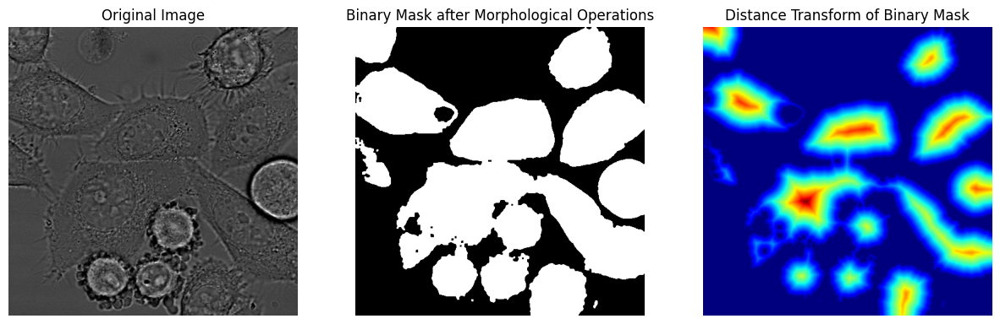

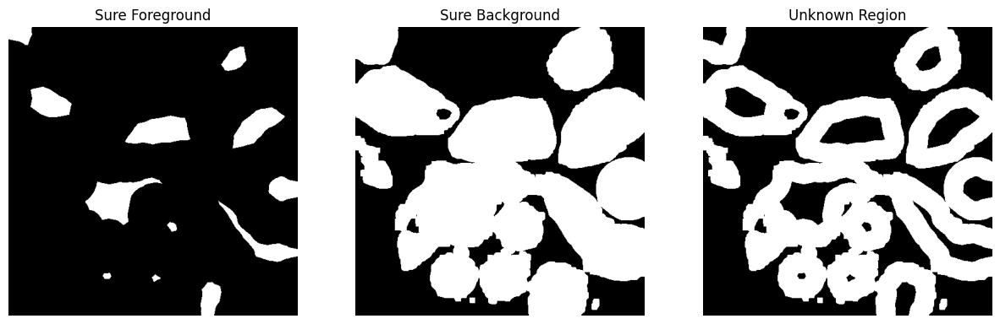

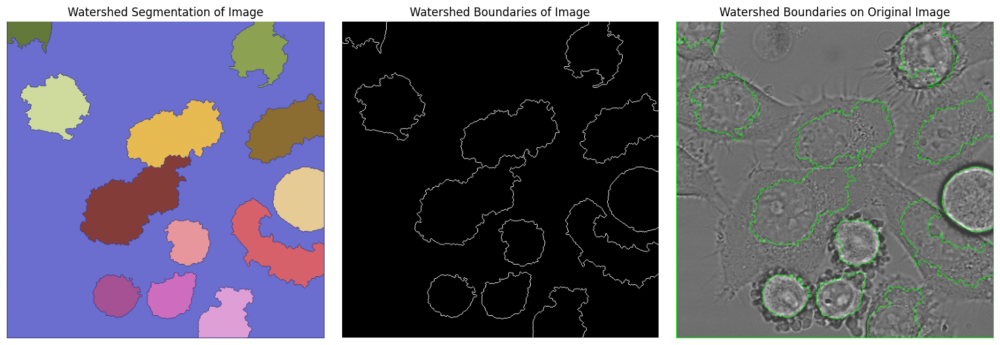

In [ ]:
kernel = np.ones((3,3), np.uint8)
image_cpu = (((image.squeeze().cpu().detach().numpy())) * 255).astype(np.uint8)

mask = get_binary_mask(model=model, device=device, img=image)
mask = opening(mask, kernel)
mask = closing(mask, kernel)
mask = mask.astype(np.uint8) * 255

dist = cv2.distanceTransform(mask, cv2.DIST_L2, 5)



k = 0.5
_, sure_fg = cv2.threshold(dist, k*dist.max(), 255, 0)
sure_fg = np.uint8(sure_fg)
sure_bg = cv2.dilate(mask, kernel, iterations=3)
unknown = cv2.subtract(sure_bg, sure_fg)




_, markers = cv2.connectedComponents(sure_fg)
markers = markers + 1
markers[unknown == 1] = 0

rgb = np.stack([image_cpu,image_cpu,image_cpu], axis=-1)
img = rgb.copy()

markers = cv2.watershed(rgb, markers)

img[markers == -1] = [0,255,0]

plt.figure(figsize=(15,5))
plt.subplot(1,3,1); plt.imshow(image_cpu, cmap="gray"); plt.axis("off");plt.title("Original Image")
plt.subplot(1,3,2); plt.imshow(mask, cmap="gray"); plt.axis("off");plt.title("Binary Mask after Morphological Operations")
plt.subplot(1,3,3);plt.imshow(dist, cmap="jet"); plt.axis("off");plt.title("Distance Transform of Binary Mask")
plt.show()

plt.figure(figsize=(15,5))
plt.subplot(1,3,1); plt.imshow(sure_fg, cmap="gray"); plt.axis("off");plt.title("Sure Foreground")
plt.subplot(1,3,2); plt.imshow(sure_bg, cmap="gray"); plt.axis("off");plt.title("Sure Background")
plt.subplot(1,3,3);plt.imshow(unknown, cmap="gray"); plt.axis("off");plt.title("Unknown Region")
plt.show()

plt.figure(figsize=(15,5));plt.subplot(1,3,1);plt.imshow(markers, cmap="tab20b");plt.axis("off");plt.title(f"Watershed Segmentation of Image");
plt.subplot(1,3,2);plt.imshow(markers == -1, cmap="gray");plt.axis("off");plt.title(f"Watershed Boundaries of Image")


plt.subplot(1,3,3);plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB));plt.axis("off");plt.title(f"Watershed Boundaries on Original Image")

plt.tight_layout()
plt.show()
